In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy as sc
import seaborn as sns
%matplotlib inline

In [2]:
fileLoc = '/home/uttam/Documents/Codes/Python/Data_Science_Project/BankChurners.csv'
df = pd.read_csv(fileLoc)

In [3]:
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [4]:
df.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,0.159997,0.840003
std,3.690378e+07,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,0.365301,0.365301
min,7.080821e+08,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,0.000008,0.000420
25%,7.130368e+08,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,0.000099,0.999660
50%,7.179264e+08,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,0.000181,0.999820
75%,7.731435e+08,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,0.000337,0.999900
max,8.283431e+08,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,0.999580,0.999990


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

* From the above information, we can see that there are few columns that are of type="object", which have to be converted to int or float. 

Removing below columns as they are not concerned with our analysis.

In [6]:
df.drop(["Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1","Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2"],axis=1,inplace=True)
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


We shall setup dummy variables for the "Attrition_Flag" column and drop the same. Further,we can even reduce it to a single column since our goal is to predict the "attrited customers" adn the customer is wither Attrited or Existing. Hence, we can drop the "Existing Customer" column.

In [7]:
dum = pd.get_dummies(df["Attrition_Flag"])
dum.head()

,Attrited Customer,Existing Customer
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1


In [8]:
df = pd.concat([df,dum],axis=1)
df.drop(["Attrition_Flag","Existing Customer"],axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer
0,768805383,45,M,3,High School,Married,$60K - $80K,Blue,39,5,...,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0
1,818770008,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,...,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0
2,713982108,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,...,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0
3,769911858,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,...,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0
4,709106358,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,...,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0


Similarly, we shall do the same for the "Gender" column and drop both the "Gender" and "Gender_M" columns.

In [9]:
dumGender = pd.get_dummies(df["Gender"],prefix="Gender")
df = pd.concat([df,dumGender],axis=1)
df.drop(["Gender","Gender_M"],axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer,Gender_F
0,768805383,45,3,High School,Married,$60K - $80K,Blue,39,5,1,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0,0
1,818770008,49,5,Graduate,Single,Less than $40K,Blue,44,6,1,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0,1
2,713982108,51,3,Graduate,Married,$80K - $120K,Blue,36,4,1,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0,0
3,769911858,40,4,High School,Unknown,Less than $40K,Blue,34,3,4,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0,1
4,709106358,40,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0,0


If we observe, we can most definitely do something similar for the columns "Education_Level", "Marital_Status", "Income Category" and "Card_Category" with multi-variables.

In [10]:
dumEdu = pd.get_dummies(df["Education_Level"],prefix="Edu")
dumEdu.head()

,Edu_College,Edu_Doctorate,Edu_Graduate,Edu_High School,Edu_Post-Graduate,Edu_Uneducated,Edu_Unknown
0,0,0,0,1,0,0,0
1,0,0,1,0,0,0,0
2,0,0,1,0,0,0,0
3,0,0,0,1,0,0,0
4,0,0,0,0,0,1,0


From the above result, we can notice that there are 7 new dummy columns generated from the "Education_Level" column alone! We need to reduce this to a single column.

We shall recreate the column with the below legend:
* High School = 1
* College = 2
* Graduate = 3
* Doctorate = 4
* Post_Grad = 5
* UnEd = 6
* Unknown = 0

In [11]:
Edu_Level = []
for idx in range(len(df)):
    if df.loc[idx]["Education_Level"]=="High School":
        Edu_Level.append(int(1))
    elif df.loc[idx]["Education_Level"]=="College":
        Edu_Level.append(int(2))
    elif df.loc[idx]["Education_Level"]=="Graduate":
        Edu_Level.append(int(3))
    elif df.loc[idx]["Education_Level"]=="Doctorate":
        Edu_Level.append(int(4))
    elif df.loc[idx]["Education_Level"]=="Post-Graduate":
        Edu_Level.append(int(5))
    elif df.loc[idx]["Education_Level"]=="Uneducated":
        Edu_Level.append(int(6))
    else:
        Edu_Level.append(int(0))

In [12]:
len(Edu_Level)

10127

In [13]:
df["Edu_Level"]=Edu_Level
df.drop("Education_Level",axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,...,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer,Gender_F,Edu_Level
0,768805383,45,3,Married,$60K - $80K,Blue,39,5,1,3,...,777,11914.0,1.335,1144,42,1.625,0.061,0,0,1
1,818770008,49,5,Single,Less than $40K,Blue,44,6,1,2,...,864,7392.0,1.541,1291,33,3.714,0.105,0,1,3
2,713982108,51,3,Married,$80K - $120K,Blue,36,4,1,0,...,0,3418.0,2.594,1887,20,2.333,0.000,0,0,3
3,769911858,40,4,Unknown,Less than $40K,Blue,34,3,4,1,...,2517,796.0,1.405,1171,20,2.333,0.760,0,1,1
4,709106358,40,3,Married,$60K - $80K,Blue,21,5,1,0,...,0,4716.0,2.175,816,28,2.500,0.000,0,0,6


In [14]:
df.Marital_Status.unique()

array(['Married', 'Single', 'Unknown', 'Divorced'], dtype=object)

Legend for Marital_Status:
* Single = 1
* Married = 2
* Divorced = 3
* Unknown = 0

In [15]:
Mar_Stat = []
for idx in range(len(df)):
    if df.loc[idx]["Marital_Status"]=="Single":
        Mar_Stat.append(int(1))
    elif df.loc[idx]["Marital_Status"]=="Married":
        Mar_Stat.append(int(2))
    elif df.loc[idx]["Marital_Status"]=="Divorced":
        Mar_Stat.append(int(3))
    else:
        Mar_Stat.append(int(0))

In [16]:
len(Mar_Stat)

10127

In [17]:
df["Marital_Stat"]=Mar_Stat
df.drop("Marital_Status",axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,...,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer,Gender_F,Edu_Level,Marital_Stat
0,768805383,45,3,$60K - $80K,Blue,39,5,1,3,12691.0,...,11914.0,1.335,1144,42,1.625,0.061,0,0,1,2
1,818770008,49,5,Less than $40K,Blue,44,6,1,2,8256.0,...,7392.0,1.541,1291,33,3.714,0.105,0,1,3,1
2,713982108,51,3,$80K - $120K,Blue,36,4,1,0,3418.0,...,3418.0,2.594,1887,20,2.333,0.000,0,0,3,2
3,769911858,40,4,Less than $40K,Blue,34,3,4,1,3313.0,...,796.0,1.405,1171,20,2.333,0.760,0,1,1,0
4,709106358,40,3,$60K - $80K,Blue,21,5,1,0,4716.0,...,4716.0,2.175,816,28,2.500,0.000,0,0,6,2


In [18]:
df.Card_Category.unique()

array(['Blue', 'Gold', 'Silver', 'Platinum'], dtype=object)

Card_Category Legend:
* Blue = 1
* Silver = 2
* Gold = 3
* Platinum = 4

In [19]:
Card_Catg = []
for idx in range(len(df)):
    if df.loc[idx]["Card_Category"]=="Blue":
        Card_Catg.append(int(1))
    elif df.loc[idx]["Card_Category"]=="Silver":
        Card_Catg.append(int(2))
    elif df.loc[idx]["Card_Category"]=="Gold":
        Card_Catg.append(int(3))
    else:
        Card_Catg.append(int(4))

In [20]:
len(Card_Catg)

10127

In [21]:
df["Card_Catg"]=Card_Catg
df.drop("Card_Category",axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Income_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,...,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer,Gender_F,Edu_Level,Marital_Stat,Card_Catg
0,768805383,45,3,$60K - $80K,39,5,1,3,12691.0,777,...,1.335,1144,42,1.625,0.061,0,0,1,2,1
1,818770008,49,5,Less than $40K,44,6,1,2,8256.0,864,...,1.541,1291,33,3.714,0.105,0,1,3,1,1
2,713982108,51,3,$80K - $120K,36,4,1,0,3418.0,0,...,2.594,1887,20,2.333,0.000,0,0,3,2,1
3,769911858,40,4,Less than $40K,34,3,4,1,3313.0,2517,...,1.405,1171,20,2.333,0.760,0,1,1,0,1
4,709106358,40,3,$60K - $80K,21,5,1,0,4716.0,0,...,2.175,816,28,2.500,0.000,0,0,6,2,1


In [22]:
df.Income_Category.unique()

array(['$60K - $80K', 'Less than $40K', '$80K - $120K', '$40K - $60K',
       '$120K +', 'Unknown'], dtype=object)

Income_Category Legend:
* <40 = 1
* 40 - 60 = 2
* 60 - 80 = 3
* 80 - 120 = 4
* 120> = 5
* Unknown = 0

In [23]:
incomeCat = []
for idx in range(len(df)):
    if df.loc[idx]["Income_Category"]=="Less than $40K":
        incomeCat.append(int(1))
    elif df.loc[idx]["Income_Category"]=="$40K - $60K":
        incomeCat.append(int(2))
    elif df.loc[idx]["Income_Category"]=="$60K - $80K":
        incomeCat.append(int(3))
    elif df.loc[idx]["Income_Category"]=="$80K - $120K":
        incomeCat.append(int(4))
    elif df.loc[idx]["Income_Category"]=="$120K +":
        incomeCat.append(int(5))
    else:
        incomeCat.append(int(0))

In [24]:
len(incomeCat)

10127

In [25]:
df["Income_Cat"]=incomeCat
df.drop("Income_Category",axis=1,inplace=True)
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,...,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrited Customer,Gender_F,Edu_Level,Marital_Stat,Card_Catg,Income_Cat
0,768805383,45,3,39,5,1,3,12691.0,777,11914.0,...,1144,42,1.625,0.061,0,0,1,2,1,3
1,818770008,49,5,44,6,1,2,8256.0,864,7392.0,...,1291,33,3.714,0.105,0,1,3,1,1,1
2,713982108,51,3,36,4,1,0,3418.0,0,3418.0,...,1887,20,2.333,0.000,0,0,3,2,1,4
3,769911858,40,4,34,3,4,1,3313.0,2517,796.0,...,1171,20,2.333,0.760,0,1,1,0,1,1
4,709106358,40,3,21,5,1,0,4716.0,0,4716.0,...,816,28,2.500,0.000,0,0,6,2,1,3


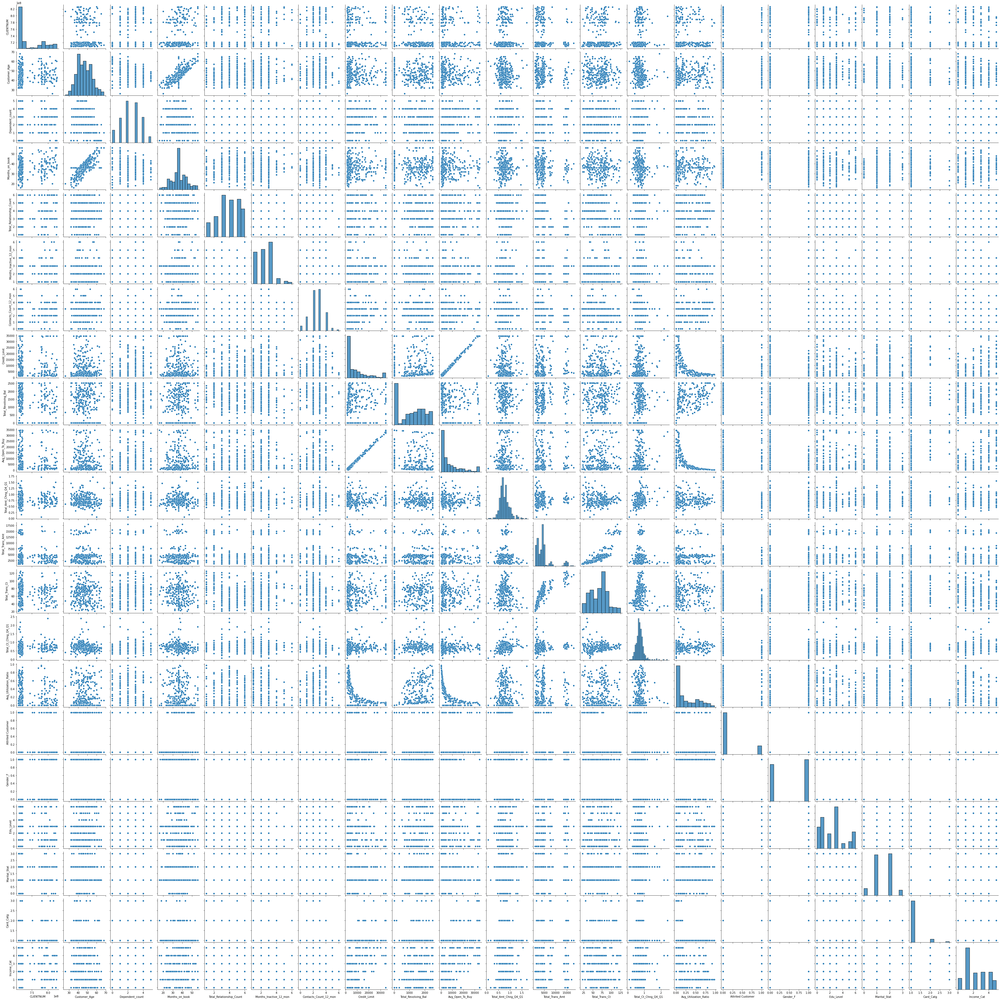

In [26]:
pair_plot = sns.pairplot(df.sample(300),kind='scatter')

In [29]:
pair_plot.savefig("Churner_pairplot.png")

In [26]:
df.columns

Index(['CLIENTNUM', 'Customer_Age', 'Dependent_count', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Attrited Customer', 'Gender_F', 'Edu_Level', 'Marital_Stat',
       'Card_Catg', 'Income_Cat'],
      dtype='object')

<AxesSubplot:xlabel='Card_Catg', ylabel='count'>

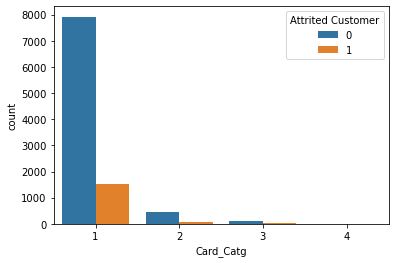

In [27]:
sns.countplot(data=df,x="Card_Catg",hue="Attrited Customer")

From the above plot, we can see that plot is highly skewed towards "1" i.e. most of the customer base belongs to the "Blue" card category. Since the attrition rate for the "platinum" category is almost negligible and their sample size is quiet small comparitively, we shall drop the records for the same.

In [26]:
for inx in range(len(df)):
    if df.loc[inx]["Card_Catg"] == int(4):
        df.drop(index=inx,inplace=True)

In [27]:
df.index=range(len(df))

The above step ensures that the index number are in sequence and there are no missing index values after dropping rows.

In [32]:
df[df["Card_Catg"]==int(4)].count()

CLIENTNUM                   0
Customer_Age                0
Dependent_count             0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
Attrited Customer           0
Gender_F                    0
Edu_Level                   0
Marital_Stat                0
Card_Catg                   0
Income_Cat                  0
dtype: int64

Also, we need to remove records pertaining to all unknown categories as they will affect the outcome of our predictor and lead to inaccurate predictions.

In [28]:
inx=0
for inx in range(len(df)):
    if df.loc[inx]["Edu_Level"] == int(0):
        df.drop(index=inx,inplace=True)
    elif df.loc[inx]["Marital_Stat"] == int(0):
        df.drop(index=inx,inplace=True)
    elif df.loc[inx]["Income_Cat"] == int(0):
        df.drop(index=inx,inplace=True)

In [29]:
df.index=range(len(df))

In [51]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7070 entries, 0 to 7069
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 7070 non-null   int64  
 1   Customer_Age              7070 non-null   int64  
 2   Dependent_count           7070 non-null   int64  
 3   Months_on_book            7070 non-null   int64  
 4   Total_Relationship_Count  7070 non-null   int64  
 5   Months_Inactive_12_mon    7070 non-null   int64  
 6   Contacts_Count_12_mon     7070 non-null   int64  
 7   Credit_Limit              7070 non-null   float64
 8   Total_Revolving_Bal       7070 non-null   int64  
 9   Avg_Open_To_Buy           7070 non-null   float64
 10  Total_Amt_Chng_Q4_Q1      7070 non-null   float64
 11  Total_Trans_Amt           7070 non-null   int64  
 12  Total_Trans_Ct            7070 non-null   int64  
 13  Total_Ct_Chng_Q4_Q1       7070 non-null   float64
 14  Avg_Util

<AxesSubplot:xlabel='Attrited Customer', ylabel='Months_Inactive_12_mon'>

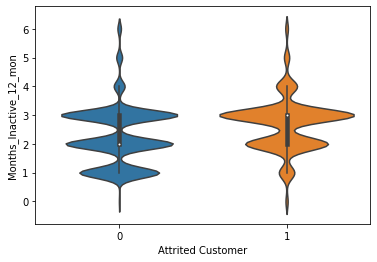

In [60]:
sns.violinplot(data=df,x="Attrited Customer",y="Months_Inactive_12_mon")

<AxesSubplot:xlabel='Credit_Limit', ylabel='Avg_Utilization_Ratio'>

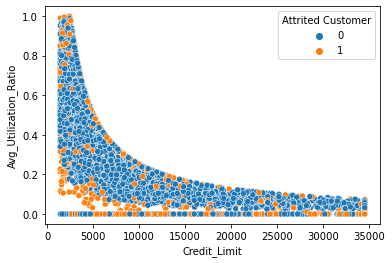

In [68]:
sns.scatterplot(data=df,x="Credit_Limit",y="Avg_Utilization_Ratio",hue="Attrited Customer")

In [30]:
df["Attrited_Cust"] = df["Attrited Customer"]
df.drop("Attrited Customer",axis=1,inplace=True)

In [43]:
df.head()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,...,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_F,Edu_Level,Marital_Stat,Card_Catg,Income_Cat,Attrited_Cust
0,768805383,45,3,39,5,1,3,12691.0,777,11914.0,...,1144,42,1.625,0.061,0,1,2,1,3,0
1,818770008,49,5,44,6,1,2,8256.0,864,7392.0,...,1291,33,3.714,0.105,1,3,1,1,1,0
2,713982108,51,3,36,4,1,0,3418.0,0,3418.0,...,1887,20,2.333,0.000,0,3,2,1,4,0
3,709106358,40,3,21,5,1,0,4716.0,0,4716.0,...,816,28,2.500,0.000,0,6,2,1,3,0
4,713061558,44,2,36,3,1,2,4010.0,1247,2763.0,...,1088,24,0.846,0.311,0,3,2,1,2,0


# Now that our data has been prepared, we shall begin working on our prediction model.

We shall use the KNN Method for predicting the attrited customers.
For that, we shall first scale our dataframe since the KNN method predicts the class of a particular test observation based on the observations that are nearest o it.

In [39]:
from sklearn.preprocessing import StandardScaler

In [40]:
scaler = StandardScaler()

In [41]:
scaler.fit(df.drop("Attrited_Cust",axis=1))

StandardScaler()

In [47]:
scaled_feat = scaler.transform(df.drop('Attrited_Cust',axis=1))

In [49]:
df_feat = pd.DataFrame(scaled_feat,columns=df.columns[:-1])
df_feat.head()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_F,Edu_Level,Marital_Stat,Card_Catg,Income_Cat
0,0.805796,-0.167487,0.512732,0.377006,0.763348,-1.348634,0.493815,0.465148,-0.480339,0.507704,2.573383,-0.937046,-0.944424,3.824955,-0.795196,-0.954905,-1.237058,0.541874,-0.253754,0.485486
1,2.161440,0.329683,2.060890,1.001610,1.410998,-1.348634,-0.411363,-0.022616,-0.373239,0.010722,3.496236,-0.894550,-1.322927,12.573205,-0.637361,1.047224,-0.056124,-1.071879,-0.253754,-0.990492
2,-0.681674,0.578268,0.512732,0.002244,0.115698,-1.348634,-2.221717,-0.554702,-1.436851,-0.426034,8.213536,-0.722254,-1.869652,6.789896,-1.014013,-0.954905,-0.056124,0.541874,-0.253754,1.223475
3,-0.813963,-0.788950,0.512732,-1.871566,0.763348,-1.348634,-2.221717,-0.411948,-1.436851,-0.283379,6.336471,-1.031867,-1.533206,7.489253,-1.014013,-0.954905,1.715278,0.541874,-0.253754,0.485486
4,-0.706650,-0.291780,-0.261348,0.002244,-0.531953,-1.348634,-0.411363,-0.489594,0.098246,-0.498020,2.757058,-0.953235,-1.701429,0.562683,0.101596,-0.954905,-0.056124,0.541874,-0.253754,-0.252503


## Train-test Split

In [33]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(scaled_feat,df["Attrited_Cust"],test_size=0.2)

In [53]:
from sklearn.neighbors import KNeighborsClassifier

To determine the right K value,

In [62]:
error_rate = []
for i in range(1,100):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

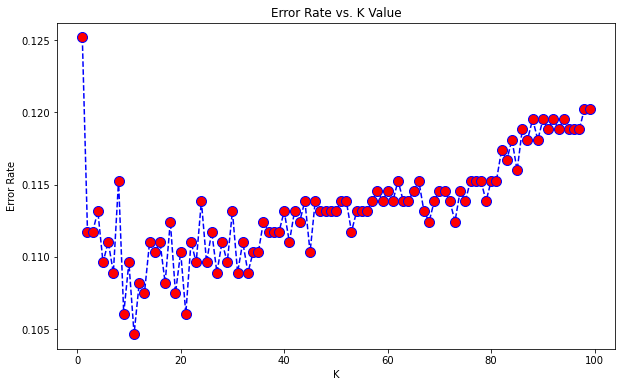

In [63]:
plt.figure(figsize=(10,6))
plt.plot(range(1,100),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

From the above plot, the best k value seems to be around 10. Let us take a closer look and determine a more precise value.

Note: Notice that as the k value increases, the error rate initially drops and after a point, starts to increase. This is an indication that our model has overfit.

In [64]:
error_rate = []
for i in range(0,20):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

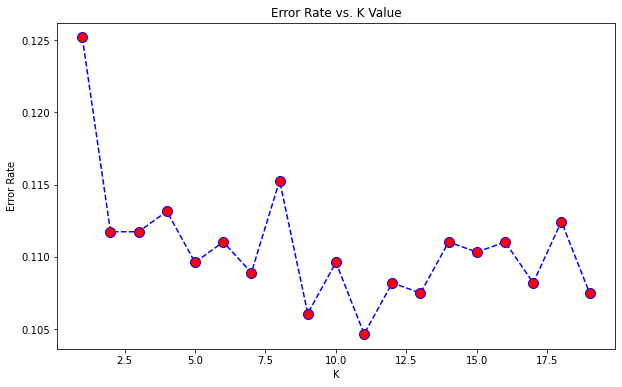

In [65]:
plt.figure(figsize=(10,6))
plt.plot(range(1,20),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

From the above plot, k=11 seems to give the lowest error rate. Hence,

In [66]:
knn = KNeighborsClassifier(n_neighbors=11)
knn.fit(X_train,y_train)
pred = knn.predict(X_test)

In [39]:
from sklearn.metrics import classification_report,confusion_matrix

In [68]:
print(confusion_matrix(y_test,pred))

[[1177   19]
 [ 129   89]]


In [69]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.90      0.98      0.94      1196
           1       0.82      0.41      0.55       218

    accuracy                           0.90      1414
   macro avg       0.86      0.70      0.74      1414
weighted avg       0.89      0.90      0.88      1414



From the above report, we can see that our prediction model was quiet accurately able to determine the non-attrited customers from the data provided. Seems like the sample size for attrited customers is not large enough.

Let us now try to predict the outcome using the Random Forest Method and compare it with the above.

In [37]:
A = df.drop("Attrited_Cust",axis=1)
b = df["Attrited_Cust"]

In [38]:
A_train,A_test,b_train,b_test = train_test_split(A,b,test_size=0.3) 

In [32]:
from sklearn.ensemble import RandomForestClassifier

In [41]:
rfc = RandomForestClassifier(n_estimators=100)
rfc.fit(A_train,b_train)
rfc_pred = rfc.predict(A_test)

In [42]:
print(confusion_matrix(b_test,rfc_pred))

[[1786   27]
 [  61  247]]


In [43]:
print(classification_report(b_test,rfc_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1813
           1       0.90      0.80      0.85       308

    accuracy                           0.96      2121
   macro avg       0.93      0.89      0.91      2121
weighted avg       0.96      0.96      0.96      2121



In [46]:
print(rfc_pred)

[1 0 0 ... 0 0 1]


Great! The Random Forest Method seems to perform better than the KNN method and get is able to predict the attrited customers 90% of the time. In fact, unlike KNN, it even predicted the customer who would not churn almost perfectly.

# Conclusion: The Random Forest Method is ideal for predicting customers that may churn and will help the client's customer satisfaction team with approaching such customers before they do.
